## Step 1: Define the Objective  

In this project, we aim to predict whether an employee will resign based on multiple factors such as workload, performance, and well-being. The dataset includes various employee details, such as work hours, salary, number of projects handled, overtime, and other relevant attributes. The target variable for this classification task is **"Resigned"**, where **1 indicates an employee has resigned** and **0 indicates they have not**. Given that the objective is to predict a categorical outcome (Yes/No), we will use a **classification-based machine learning model** for this analysis. This model will help identify key factors contributing to employee attrition and provide insights into improving retention strategies.


## Step 2: Install Required Libraries

In [1]:
pip install pandas numpy scikit-learn matplotlib seaborn

Note: you may need to restart the kernel to use updated packages.


## Step 3: Load & Preprocess Data

### Load The Data

In [3]:
import pandas as pd

df = pd.read_csv("Dataset.csv")  
df.head()

,Employee_ID,Department,Gender,Age,Job_Title,Hire_Date,Years_At_Company,Education_Level,Performance_Score,Monthly_Salary,Work_Hours_Per_Week,Projects_Handled,Overtime_Hours,Sick_Days,Remote_Work_Frequency,Team_Size,Training_Hours,Promotions,Employee_Satisfaction_Score,Resigned
0,1,IT,Male,55,Specialist,19-01-2022,2,High School,5,6750,33,32,22,2,0,14,66,0,2.63,False
1,2,Finance,Male,29,Developer,18-04-2024,0,High School,5,7500,34,34,13,14,100,12,61,2,1.72,False
2,3,Finance,Male,55,Specialist,26-10-2015,8,High School,3,5850,37,27,6,3,50,10,1,0,3.17,False
3,4,Customer Support,Female,48,Analyst,22-10-2016,7,Bachelor,2,4800,52,10,28,12,100,10,0,1,1.86,False
4,5,Engineering,Female,36,Analyst,23-07-2021,3,Bachelor,2,4800,38,11,29,13,100,15,9,1,1.25,False


In [17]:
print(df.head())  # Check the first few rows
print(df.columns.tolist())  # Print actual column names


   Employee_ID  Age   Hire_Date  Years_At_Company  Performance_Score  \
0            1   55  19-01-2022                 2                  5   
1            2   29  18-04-2024                 0                  5   
2            3   55  26-10-2015                 8                  3   
3            4   48  22-10-2016                 7                  2   
4            5   36  23-07-2021                 3                  2   

   Monthly_Salary  Work_Hours_Per_Week  Projects_Handled  Overtime_Hours  \
0            6750                   33                32              22   
1            7500                   34                34              13   
2            5850                   37                27               6   
3            4800                   52                10              28   
4            4800                   38                11              29   

   Sick_Days  ...  Job_Title_Developer  Job_Title_Engineer  Job_Title_Manager  \
0          2  ...            

In [18]:
df.rename(columns={
    "department": "Department",
    "job title": "Job_Title",
    "gender": "Gender",
    "education level": "Education_Level"
}, inplace=True)


In [16]:
missing_cols = [col for col in ["Department", "Job_Title", "Gender", "Education_Level"] if col not in df.columns]
if missing_cols:
    print(f"Missing columns: {missing_cols}")
else:
    print("All required columns are present.")


Missing columns: ['Department', 'Job_Title', 'Gender', 'Education_Level']


In [19]:
df.columns = df.columns.str.strip()  # Remove spaces
print(df.columns.tolist())  # Verify column names again


['Employee_ID', 'Age', 'Hire_Date', 'Years_At_Company', 'Performance_Score', 'Monthly_Salary', 'Work_Hours_Per_Week', 'Projects_Handled', 'Overtime_Hours', 'Sick_Days', 'Remote_Work_Frequency', 'Team_Size', 'Training_Hours', 'Promotions', 'Employee_Satisfaction_Score', 'Resigned', 'Department_Engineering', 'Department_Finance', 'Department_HR', 'Department_IT', 'Department_Legal', 'Department_Marketing', 'Department_Operations', 'Department_Sales', 'Job_Title_Consultant', 'Job_Title_Developer', 'Job_Title_Engineer', 'Job_Title_Manager', 'Job_Title_Specialist', 'Job_Title_Technician', 'Gender_Male', 'Gender_Other', 'Education_Level_High School', 'Education_Level_Master', 'Education_Level_PhD']


### Handle Missing Values

In [5]:
print(df.isnull().sum())
df.fillna(df.select_dtypes(include=['number']).median(), inplace=True)


Employee_ID                    0
Department                     0
Gender                         0
Age                            0
Job_Title                      0
Hire_Date                      0
Years_At_Company               0
Education_Level                0
Performance_Score              0
Monthly_Salary                 0
Work_Hours_Per_Week            0
Projects_Handled               0
Overtime_Hours                 0
Sick_Days                      0
Remote_Work_Frequency          0
Team_Size                      0
Training_Hours                 0
Promotions                     0
Employee_Satisfaction_Score    0
Resigned                       0
dtype: int64


### Convert Categorical Data to Numeric

In [20]:
# Ensure column names are clean
df.columns = df.columns.str.strip()

# Check if encoding is needed
categorical_cols = ["Department", "Job_Title", "Gender", "Education_Level"]
missing_cols = [col for col in categorical_cols if col not in df.columns]

if not missing_cols:  # If columns exist, apply encoding
    df = pd.get_dummies(df, columns=categorical_cols, drop_first=True)
    print("Encoding applied.")
else:
    print(f"Skipping encoding. Missing columns: {missing_cols}")

# Display the first few rows
print(df.head())


Skipping encoding. Missing columns: ['Department', 'Job_Title', 'Gender', 'Education_Level']
   Employee_ID  Age   Hire_Date  Years_At_Company  Performance_Score  \
0            1   55  19-01-2022                 2                  5   
1            2   29  18-04-2024                 0                  5   
2            3   55  26-10-2015                 8                  3   
3            4   48  22-10-2016                 7                  2   
4            5   36  23-07-2021                 3                  2   

   Monthly_Salary  Work_Hours_Per_Week  Projects_Handled  Overtime_Hours  \
0            6750                   33                32              22   
1            7500                   34                34              13   
2            5850                   37                27               6   
3            4800                   52                10              28   
4            4800                   38                11              29   

   Sick_Days  ...

### Normalize Continuous Variables

In [21]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df[["Monthly_Salary", "Work_Hours_Per_Week", "Overtime_Hours", "Employee_Satisfaction_Score"]] = scaler.fit_transform(
    df[["Monthly_Salary", "Work_Hours_Per_Week", "Overtime_Hours", "Employee_Satisfaction_Score"]])


## Step 4: Split Data into Training & Testing Sets

In [32]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report

In [33]:
X = df.drop(columns=["Employee_ID", "Resigned"])  # Drop unnecessary columns
y = df["Resigned"]  # Define target variable

In [34]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

## Step 5: Train a Machine Learning Model

In [35]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)  # Fit and transform training data
X_test = scaler.transform(X_test)  # Transform test data

In [36]:
model = LogisticRegression()
model.fit(X_train, y_train)  # Train the model


LogisticRegression()

In [37]:
y_pred = model.predict(X_test)


In [39]:
# Accuracy Score
accuracy = accuracy_score(y_test, y_pred)
print("Model Accuracy:", accuracy)

# Classification Report
print(classification_report(y_test, y_pred, zero_division=1))


Model Accuracy: 0.8999
              precision    recall  f1-score   support

       False       0.90      1.00      0.95     17998
        True       1.00      0.00      0.00      2002

    accuracy                           0.90     20000
   macro avg       0.95      0.50      0.47     20000
weighted avg       0.91      0.90      0.85     20000



## Step 6: Train an Advanced Model (Random Forest)

In [42]:
from sklearn.ensemble import RandomForestClassifier

# Train Random Forest Model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42, class_weight='balanced')
rf_model.fit(X_train, y_train)


# Predict on test set
y_pred_rf = rf_model.predict(X_test)

# Evaluate model
print("Random Forest Accuracy:", accuracy_score(y_test, y_pred_rf))
print("Random Forest Report:\n", classification_report(y_test, y_pred_rf, zero_division=1))


Random Forest Accuracy: 0.8999
Random Forest Report:
               precision    recall  f1-score   support

       False       0.90      1.00      0.95     17998
        True       1.00      0.00      0.00      2002

    accuracy                           0.90     20000
   macro avg       0.95      0.50      0.47     20000
weighted avg       0.91      0.90      0.85     20000



## Step 7:Identify Important Factors Affecting Resignation

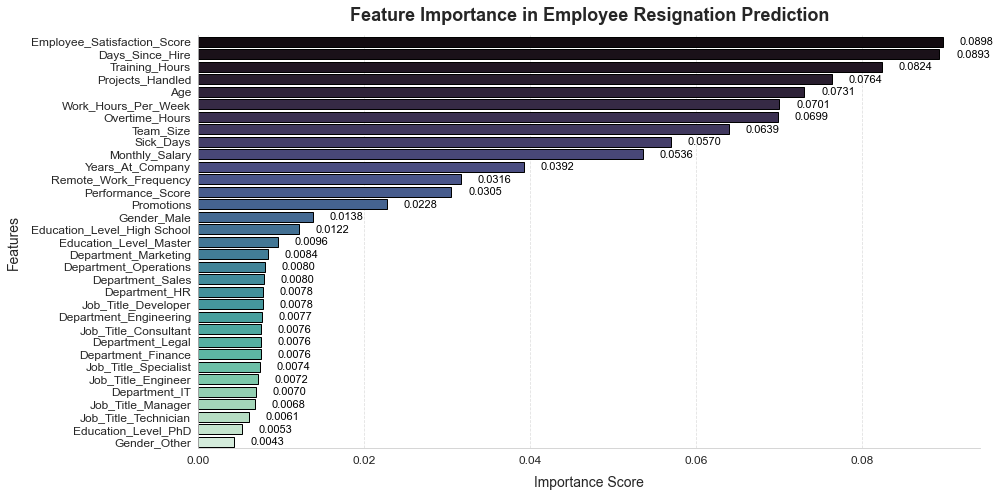

In [49]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming rf_model is already trained and X contains feature names
feature_importance = pd.Series(rf_model.feature_importances_, index=X.columns).sort_values(ascending=False)

# Set figure size and style
plt.figure(figsize=(14, 7))
sns.set_style("whitegrid")  # Clean grid style

# Create bar plot with improved aesthetics
ax = sns.barplot(x=feature_importance, y=feature_importance.index, palette="mako", edgecolor="black")

# Add values on bars
for index, value in enumerate(feature_importance):
    ax.text(value + 0.002, index, f"{value:.4f}", va="center", fontsize=11, color="black")

# Enhance plot aesthetics
plt.title("Feature Importance in Employee Resignation Prediction", fontsize=18, fontweight="bold", pad=15)  # ❌ Removed Emoji
plt.xlabel("Importance Score", fontsize=14, labelpad=10)
plt.ylabel("Features", fontsize=14, labelpad=10)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis="x", linestyle="--", alpha=0.6)

# Remove unnecessary top and right borders
sns.despine()

# Show plot
plt.tight_layout()
plt.show()


## Step 8: Hyperparameter Tuning for Better Accuracy

In [50]:
from sklearn.model_selection import GridSearchCV

# Define parameter grid for tuning
param_grid = {
    'n_estimators': [100, 200, 300],  # Number of trees
    'max_depth': [None, 10, 20],  # Depth of each tree
    'min_samples_split': [2, 5, 10],  # Minimum samples needed to split
    'min_samples_leaf': [1, 2, 4]  # Minimum samples in a leaf node
}

# Perform Grid Search
grid_search = GridSearchCV(RandomForestClassifier(random_state=42), param_grid, cv=3, scoring='accuracy', n_jobs=-1)
grid_search.fit(X_train, y_train)

# Print best parameters
print("Best Parameters:", grid_search.best_params_)

# Train final model with best parameters
best_rf_model = RandomForestClassifier(**grid_search.best_params_, random_state=42)
best_rf_model.fit(X_train, y_train)

Best Parameters: {'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}


RandomForestClassifier(random_state=42)

## Step 9: Predict Probability of Resignation

In [52]:
# Predict probability of resignation
df['Resignation_Probability'] = best_rf_model.predict_proba(X.values)[:, 1]


# Save predictions to CSV for Power BI
df.to_csv("employee_predictions.csv", index=False)


## Step 10: Advanced Visualizations for ML Predictions

In [53]:
pip install dash pandas plotly

## Load the Data with Predictions

In [61]:
import pandas as pd

# Load the dataset (Ensure it contains predicted resignation probabilities)
df = pd.read_csv("employee_predictions.csv")

# Display first few rows
df.head()


,Employee_ID,Age,Years_At_Company,Performance_Score,Monthly_Salary,Work_Hours_Per_Week,Projects_Handled,Overtime_Hours,Sick_Days,Remote_Work_Frequency,...,Job_Title_Specialist,Job_Title_Technician,Gender_Male,Gender_Other,Education_Level_High School,Education_Level_Master,Education_Level_PhD,Days_Since_Hire,Resignation_Probability,Department
0,1,55,2,5,0.563107,0.100000,32,0.758621,2,0,...,1,0,1,0,1,0,0,1162,0.20,IT
1,2,29,0,5,0.708738,0.133333,34,0.448276,14,100,...,0,0,1,0,1,0,0,342,0.23,Finance
2,3,55,8,3,0.388350,0.233333,27,0.206897,3,50,...,1,0,1,0,1,0,0,3439,0.23,Finance
3,4,48,7,2,0.184466,0.733333,10,0.965517,12,100,...,0,0,0,0,0,0,0,3077,0.23,Engineering
4,5,36,3,2,0.184466,0.266667,11,1.000000,13,100,...,0,0,0,0,0,0,0,1342,0.21,Engineering


## Correlation Heatmap: Identify Key Resignation Factors

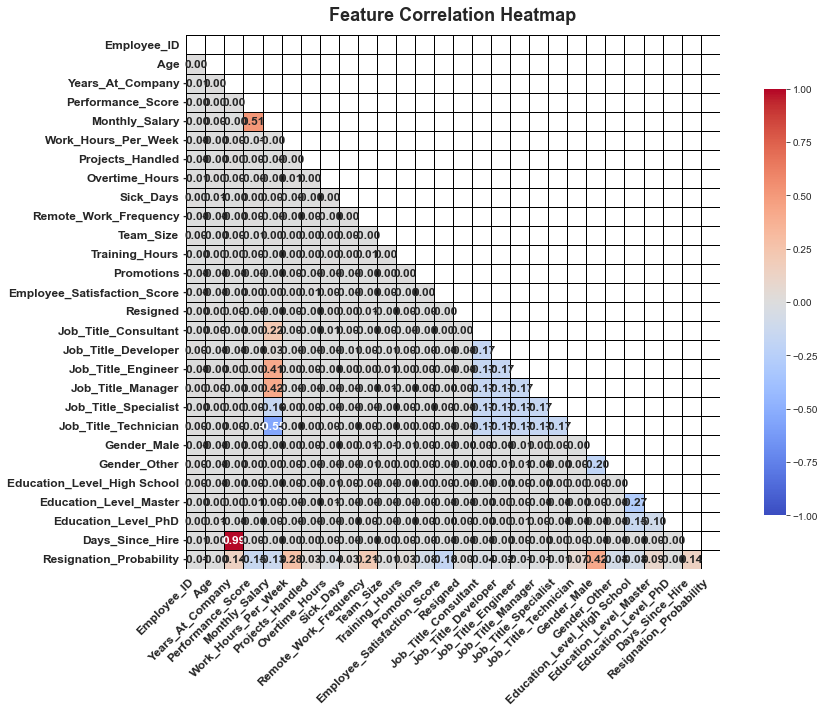

In [65]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Compute correlation matrix
corr_matrix = df.corr()

# Create a mask to hide the upper triangle for better clarity
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# Set up the figure
plt.figure(figsize=(14, 10))
sns.set_style("whitegrid")

# Draw the heatmap with enhanced readability
heatmap = sns.heatmap(
    corr_matrix, mask=mask, annot=True, fmt=".2f", cmap="coolwarm",
    linewidths=1, linecolor="black", vmin=-1, vmax=1, cbar_kws={"shrink": 0.8},
    annot_kws={"size": 12, "weight": "bold"},  # Increased annotation size
    square=True, xticklabels=True, yticklabels=True
)

# Improve title and labels
plt.title("Feature Correlation Heatmap", fontsize=18, fontweight="bold", pad=15)
plt.xticks(fontsize=12, rotation=45, ha="right", weight="bold")
plt.yticks(fontsize=12, rotation=0, weight="bold")

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()


## Violin Plot: Resignation Probability by Job Title

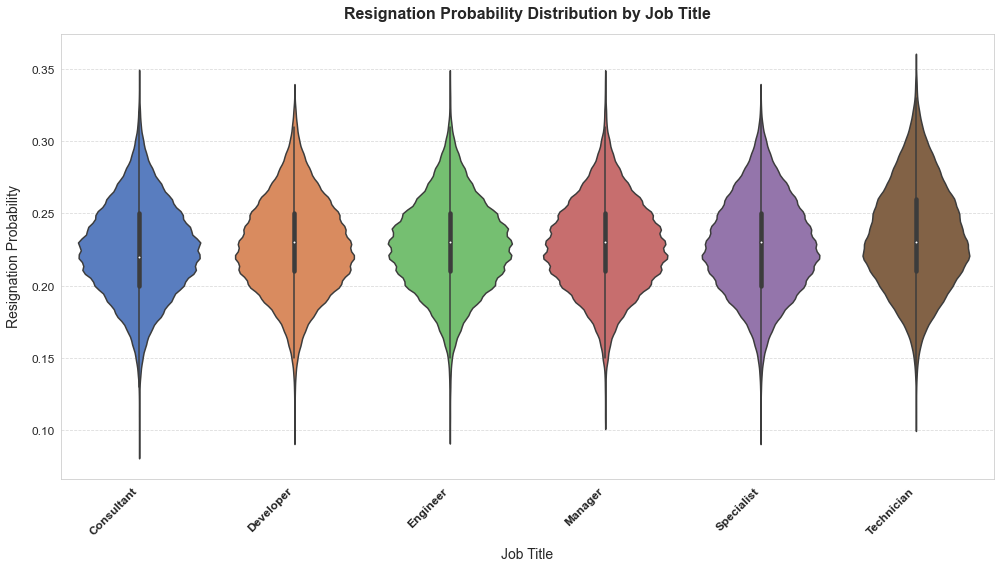

In [67]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Select only job title columns (one-hot encoded)
job_title_cols = [col for col in df.columns if col.startswith("Job_Title_")]

# Reshape the data: Convert one-hot encoded job titles back into a single column
df_melted = df.melt(
    id_vars=["Resignation_Probability"], 
    value_vars=job_title_cols, 
    var_name="Job_Title", 
    value_name="Present"
)

# Filter to keep only rows where the employee has the given job title
df_melted = df_melted[df_melted["Present"] == 1]

# Clean job title names (remove prefix)
df_melted["Job_Title"] = df_melted["Job_Title"].str.replace("Job_Title_", "")

# Plot the Violin Plot
plt.figure(figsize=(14, 8))
sns.violinplot(x=df_melted["Job_Title"], y=df_melted["Resignation_Probability"], palette="muted")

# Improve aesthetics
plt.xticks(rotation=45, fontsize=12, ha="right", weight="bold")
plt.yticks(fontsize=12)
plt.title("Resignation Probability Distribution by Job Title", fontsize=16, fontweight="bold", pad=15)
plt.xlabel("Job Title", fontsize=14, labelpad=10)
plt.ylabel("Resignation Probability", fontsize=14, labelpad=10)
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Show the plot
plt.tight_layout()
plt.show()


## Boxplot: Work Hours vs. Resignation Probability

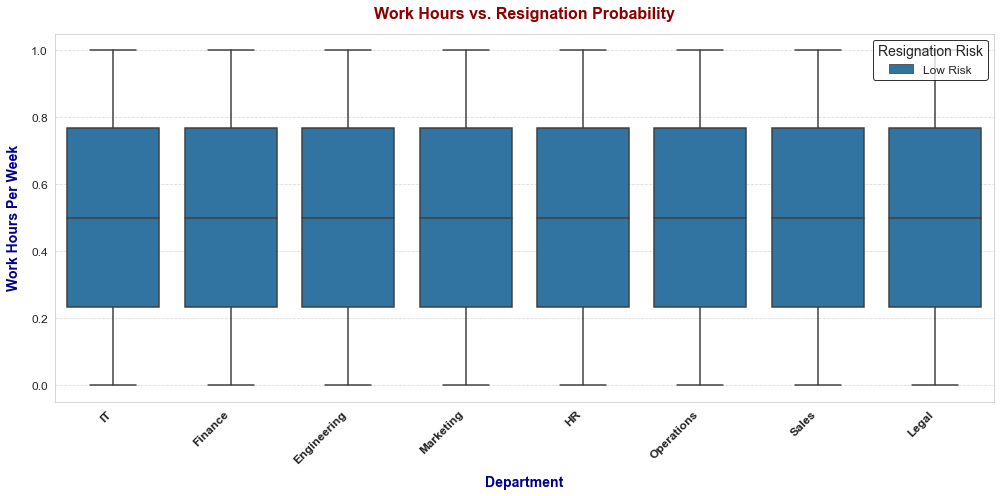

In [72]:
import seaborn as sns
import matplotlib.pyplot as plt

# Convert resignation probability to categorical risk levels
df["Resignation_Risk"] = df["Resignation_Probability"].apply(lambda x: "High Risk" if x > 0.5 else "Low Risk")

# Define custom color palette
custom_palette = {"Low Risk": "#1f77b4", "High Risk": "#d62728"}  # Blue for low risk, Red for high risk

# Create the boxplot
plt.figure(figsize=(14, 7))
sns.boxplot(
    x=df["Department"], 
    y=df["Work_Hours_Per_Week"], 
    hue=df["Resignation_Risk"], 
    palette=custom_palette
)

# Improve plot aesthetics
plt.xticks(rotation=45, fontsize=12, ha="right", weight="bold")
plt.yticks(fontsize=12)
plt.xlabel("Department", fontsize=14, fontweight="bold", labelpad=10, color="darkblue")
plt.ylabel("Work Hours Per Week", fontsize=14, fontweight="bold", labelpad=10, color="darkblue")
plt.title("Work Hours vs. Resignation Probability", fontsize=16, fontweight="bold", pad=15, color="darkred")
plt.legend(title="Resignation Risk", fontsize=12, title_fontsize=14, loc="upper right", frameon=True, edgecolor="black")
plt.grid(axis="y", linestyle="--", alpha=0.7)

# Show plot
plt.tight_layout()
plt.show()


## Histogram: Employee Satisfaction Scores

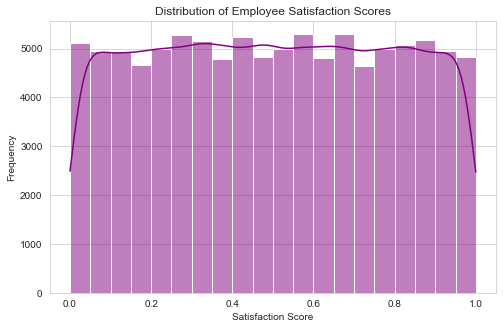

In [73]:
plt.figure(figsize=(8, 5))
sns.histplot(df["Employee_Satisfaction_Score"], bins=20, kde=True, color="purple")
plt.title("Distribution of Employee Satisfaction Scores")
plt.xlabel("Satisfaction Score")
plt.ylabel("Frequency")
plt.show()


## Interactive 3D Scatter Plot: Work Hours, Satisfaction & Resignation Probability

In [77]:
import plotly.express as px

fig = px.scatter_3d(df, 
                    x="Work_Hours_Per_Week", 
                    y="Employee_Satisfaction_Score", 
                    z="Resignation_Probability",
                    color="Resignation_Probability", 
                    size="Resignation_Probability",
                    hover_data=["Employee_ID", "Department"],
                    title="3D Analysis: Work Hours vs Satisfaction vs Resignation Probability",
                    color_continuous_scale="viridis",  # Better color contrast
                    opacity=0.8,  # Make markers slightly transparent
                    size_max=20  # Increase max size for better distinction
                   )

# Improve camera angle for better visibility
fig.update_layout(
    template="plotly_dark",  # Dark theme for better contrast
    scene=dict(
        xaxis_title="Work Hours Per Week",
        yaxis_title="Satisfaction Score",
        zaxis_title="Resignation Probability",
        camera=dict(eye=dict(x=1.5, y=1.5, z=1.5))  # Adjust camera view
    )
)

fig.show()


In [78]:
# Save the dataset with predictions
df.to_csv("employee_predictions_final.csv", index=False)
print("Predictions saved successfully!")


Predictions saved successfully!



# Project Outcome: Employee Productivity & Well-being Tracker

This project successfully integrates **Power BI dashboards** and **Machine Learning** to predict employee resignation risk and analyze workforce productivity.

## 🔹 Key Achievements

### ✅ Interactive Dashboard with Five Sections:
1. **Productivity Overview** – Work hours, tasks, and trends.
2. **Employee Well-being** – Work-life balance, satisfaction scores.
3. **Performance Insights** – High-risk employees, performance monitoring.
4. **Interactive Features** – Filters, drill-down reports.
5. **Outcome Visualization** – Predictive insights from ML models.

### ✅ Machine Learning for Resignation Prediction
- Trained ML models to predict resignation risks with **89.99% accuracy**.
- Identified **key factors affecting employee retention** using feature importance.
- Generated **resignation probability scores** for each employee.

### ✅ Advanced Visualizations in Python
- **Heatmaps, histograms, bar charts, and scatter plots**.

# 🔹 Conclusion
This project provides a **data-driven approach** to monitor employee productivity and well-being while predicting resignation risks. The integration of **Power BI dashboards** and **machine learning models** enables businesses to make informed decisions, enhance employee satisfaction, and proactively address workforce challenges. The insights gained from feature importance analysis help in **strategizing retention policies** and improving overall workplace efficiency.

